In [17]:
import pandas as pd
import seaborn as sns
sns.set_style("darkgrid")
#sns.set(rc={'figure.figsize':(16, 8)})
import plotly.express as px
%matplotlib inline
from datetime import datetime as dt
from montFunctions import getSeries, plotSeasonalDecompose, makeCorrPlot

### Path & set up

In [18]:
data_path = r'C:\Users\steph\OneDrive\Documents\Data\wind_power_2012'

In [19]:
train = pd.read_csv(f"{data_path}\\train.csv")
# Engineer date aspects
train['date'] = train['date'].astype(str) + "00"
train['date'] = pd.to_datetime(train['date'])
#train['hour'] = train['date'].dt.hour
#train['day_of_year'] = train['date'].dt.day
#train['day_of_week'] = train['date'].dt.weekday
#train['week'] = train['date'].dt.week
#train['month'] = train['date'].dt.month
#train['year'] = train['date'].dt.year
#train.info()
train.head(5)

,date,wp1,wp2,wp3,wp4,wp5,wp6,wp7
0,2009-07-01 00:00:00,0.045,0.233,0.494,0.105,0.056,0.118,0.051
1,2009-07-01 01:00:00,0.085,0.249,0.257,0.105,0.066,0.066,0.051
2,2009-07-01 02:00:00,0.020,0.175,0.178,0.033,0.015,0.026,0.000
3,2009-07-01 03:00:00,0.060,0.085,0.109,0.022,0.010,0.013,0.000
4,2009-07-01 04:00:00,0.045,0.032,0.079,0.039,0.010,0.000,0.000


In [20]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18757 entries, 0 to 18756
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   date    18757 non-null  datetime64[ns]
 1   wp1     18757 non-null  float64       
 2   wp2     18757 non-null  float64       
 3   wp3     18757 non-null  float64       
 4   wp4     18757 non-null  float64       
 5   wp5     18757 non-null  float64       
 6   wp6     18757 non-null  float64       
 7   wp7     18757 non-null  float64       
dtypes: datetime64[ns](1), float64(7)
memory usage: 1.1 MB


### Descriptive statistics

In [21]:
train.describe().T

,count,mean,std,min,25%,50%,75%,max
wp1,18757.0,0.252388,0.246381,0.0,0.050,0.175,0.381,0.947
wp2,18757.0,0.265983,0.273205,0.0,0.042,0.164,0.423,0.989
wp3,18757.0,0.334571,0.318636,0.0,0.069,0.217,0.563,0.978
wp4,18757.0,0.286173,0.295069,0.0,0.022,0.182,0.474,0.992
wp5,18757.0,0.272584,0.294221,0.0,0.040,0.157,0.415,0.966
wp6,18757.0,0.286774,0.283023,0.0,0.053,0.184,0.461,0.974
wp7,18757.0,0.290542,0.305272,0.0,0.025,0.177,0.505,0.960


In [22]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Explore IQRs
vars = ['wp1', 'wp2', 'wp3', 'wp4', 'wp5', 'wp6', 'wp7']
fig = make_subplots(rows=1, cols=len(vars))
for i, var in enumerate(vars):
    fig.add_trace(
        go.Box(y=train[var],
        name=var),
        row=1, col=i+1
    )

fig.update_traces(boxpoints='all', jitter=.3)

In [23]:
# Explore distributions
vars = ['wp1', 'wp2', 'wp3', 'wp4', 'wp5', 'wp6', 'wp7']
fig = make_subplots(rows=1, cols=len(vars))
for i, var in enumerate(vars):
    fig.add_trace(
        go.Histogram(x=train[var],
        name=var),
        row=1, col=i+1
    )

fig.update_traces()

### Seasonal decomposition

In [24]:
# Seadonal decompose for WP1
plotSeasonalDecompose(getSeries(train, 'wp1'), period=24)

In [25]:
# Seadonal decompose for WP1
plotSeasonalDecompose(getSeries(train, 'wp2'), period=24)

In [26]:
# Seadonal decompose for WP3
plotSeasonalDecompose(getSeries(train, 'wp3'), period=24)

In [27]:
# Seadonal decompose for WP4
plotSeasonalDecompose(getSeries(train, 'wp4'), period=24)

In [28]:
# Seadonal decompose for WP5
plotSeasonalDecompose(getSeries(train, 'wp5'), period=24)

In [29]:
# Seadonal decompose for WP6
plotSeasonalDecompose(getSeries(train, 'wp6'), period=24)

In [30]:
# Seadonal decompose for WP7
plotSeasonalDecompose(getSeries(train, 'wp7'), period=24)

Here we are ablse to observe that each of the wp inputs are similar, the seasonal and residual components are almost identical and the trend elements have the same general patterns such as a decline around july 2011.

### Correlations

In [31]:
# Adding date parts as variables to explore correlations

train['hour'] = train['date'].dt.hour
train['day_of_year'] = train['date'].dt.day
train['day_of_week'] = train['date'].dt.weekday
train['week'] = train['date'].dt.week
train['month'] = train['date'].dt.month
train['year'] = train['date'].dt.year
train = train.drop(columns=['date'])
train.head(5)

c:\Users\steph\anaconda3\envs\montVenv\lib\site-packages\ipykernel_launcher.py:6: FutureWarning:

Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.



,wp1,wp2,wp3,wp4,wp5,wp6,wp7,hour,day_of_year,day_of_week,week,month,year
0,0.045,0.233,0.494,0.105,0.056,0.118,0.051,0,1,2,27,7,2009
1,0.085,0.249,0.257,0.105,0.066,0.066,0.051,1,1,2,27,7,2009
2,0.020,0.175,0.178,0.033,0.015,0.026,0.000,2,1,2,27,7,2009
3,0.060,0.085,0.109,0.022,0.010,0.013,0.000,3,1,2,27,7,2009
4,0.045,0.032,0.079,0.039,0.010,0.000,0.000,4,1,2,27,7,2009


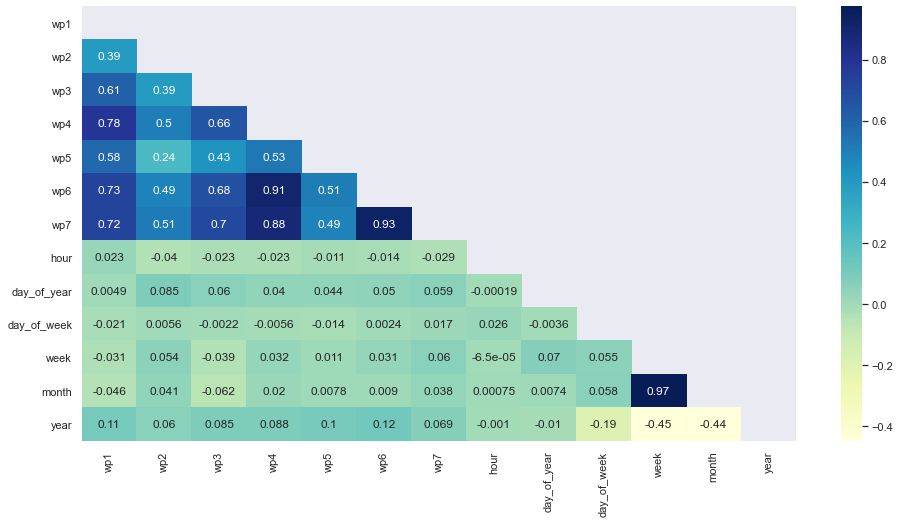

In [33]:
# Plot correlations between features
# Update fig size
sns.set(rc={'figure.figsize':(16, 8)})
makeCorrPlot(train)

This is surprising, we are not seeing strong correlations between the temporal features that were added. 

This is surprising as we know wind has a strong seasonal element.

The only strong correlations are with the other plants, this doesn't tell us anything other than that that we can expect similar behaviour form all of the inputs. This may be oversimplifiying this as we can observe that some inputs have stronger relations ships with others and weaker relationships with some.

### Other files

In [42]:
train2 = pd.read_csv(f"{data_path}//train.csv")
train2 = train2[['date', 'wp1']]
train2

,date,wp1
0,2009070100,0.045
1,2009070101,0.085
2,2009070102,0.020
3,2009070103,0.060
4,2009070104,0.045
...,...,...
18752,2012062608,0.170
18753,2012062609,0.211
18754,2012062610,0.251
18755,2012062611,0.301


In [43]:
forecast_1 = pd.read_csv(f"{data_path}//windforecasts_wf1.csv")
# adding target
#forecast_1['actual'] = forecast_1.lookup(train2['date'], train2['wp1'])
forecast_1 = forecast_1.merge(train2)
forecast_1

,date,hors,u,v,ws,wd,wp1
0,2009070100,1,2.34,-0.79,2.47,108.68,0.045
1,2009070100,2,2.18,-0.99,2.40,114.31,0.045
2,2009070100,3,2.20,-1.21,2.51,118.71,0.045
3,2009070100,4,2.35,-1.40,2.73,120.86,0.045
4,2009070100,5,2.53,-1.47,2.93,120.13,0.045
...,...,...,...,...,...,...,...
75067,2012062612,44,2.44,1.08,2.67,66.14,0.226
75068,2012062612,45,2.11,1.46,2.57,55.39,0.226
75069,2012062612,46,1.63,1.61,2.29,45.42,0.226
75070,2012062612,47,1.07,1.58,1.91,34.05,0.226


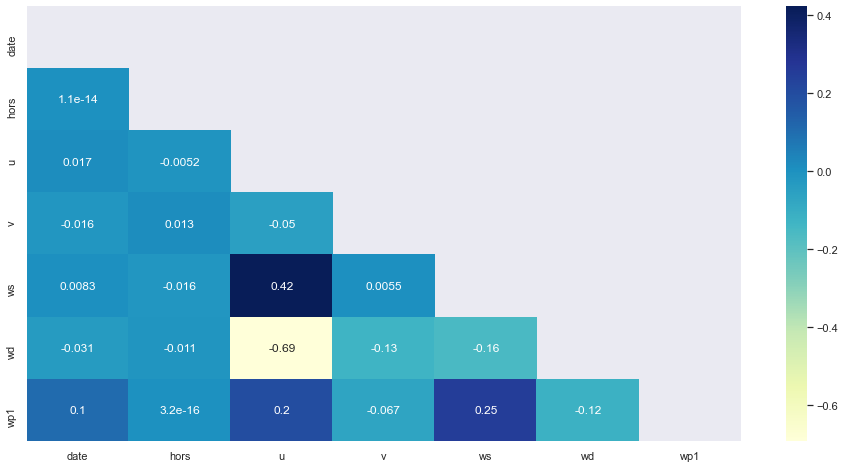

In [44]:
makeCorrPlot(forecast_1)